# Plotting DEB-PCSE Perna perna results

In [1]:
import numpy as np
import pandas as pd
import scipy.io
import matplotlib.pyplot as plt
import matplotlib.ticker as mticker
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
import seaborn as sns
import pickle
#import joypy
from matplotlib import cm
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import cartopy.io.shapereader as shpreader
from scalebar import scale_bar #Imported code from the internet

from cartopy.mpl.gridliner import LONGITUDE_FORMATTER, LATITUDE_FORMATTER

### Preparing the code

In [48]:
# Set year range
init = 2002
final = 2020
time = np.linspace(init, final, (final-init+1))
del_M = 0.043191

In [3]:
# Load better resolution brazilian maps
arquivo = shpreader.natural_earth(resolution='10m', category='cultural', name='admin_1_states_provinces')
parser = shpreader.Reader(arquivo)

In [7]:
# Open files
with open('G:\My Drive\DEB Files\Result_PCSE_STD.pickle', 'rb') as f:
    results = pickle.load(f)

lat = np.array(results['lat'])
lon = np.array(results['lon'])

In [63]:
# Get max and min from r_B
l = []
for year in results['CHL'].keys():
    l.append(results['r_B'][year]*30) #days to months
rb_max = np.nanmax(l)
rb_min = np.nanmin(l)

rb_max, rb_min

(2.100303988366382, 0.05483535179129877)

In [ ]:
# Get max and min from L_i
l = []
for year in results['CHL'].keys():
    l.append(results['L_i'][year])
li_max = np.nanmax(l)
li_min = np.nanmin(l)

li_max, li_min

## Actual plotting (automated for all years)

In [ ]:
for i in range(len(time)):
   
    # Save different variables
    L_i = results['L_i'][str(int(time[i]))]
    
    
    
    ### Start plotting for L_i
    paises = parser.records()
    fig=plt.figure(figsize=(10, 10), dpi=600)
    ax = plt.axes(projection=ccrs.PlateCarree())
    ax.add_feature(cfeature.OCEAN, facecolor = 'k')#, alpha=.8)
    ax.add_feature(cfeature.LAND, facecolor = 'k')#, alpha=.8)

    extent = [-49.5, -41.5, -29, -22.5]
    ax.set_extent(extent)

    for estado in paises:
        if estado.attributes['admin'] == 'Brazil':        
            ax.add_geometries([estado.geometry], ccrs.PlateCarree(), facecolor='darkgray', edgecolor='k')

    plt.contourf(lon, lat, L_i, cmap = 'seismic',
                 vmin=li_min, vmax=li_max, levels=9, transform=ccrs.PlateCarree())

    #cbaxes = inset_axes(ax, width="4%", height="60%",height="60%", loc=4)
    cbar = plt.colorbar(ax=ax, orientation="horizontal", shrink=.84, pad=.06)
    cbar.set_label('Ultimate physical length (cm)', fontsize = 18, labelpad = 8)

    plt.contour(lon, lat, L_i, colors='k', levels=9, transform=ccrs.PlateCarree(), linewidths=0.2)

    # Setting up gridlines
    gl = ax.gridlines(draw_labels=True, linewidth=0.6, color='white', alpha=0.9)
    gl.xlabels_top = False
    gl.ylabels_right = False
    gl.xlocator = mticker.FixedLocator([-52, -50, -48, -46, -44, -42, -40, -38])
    gl.ylocator = mticker.FixedLocator([-21, -23, -25, -27, -29, -31])
    gl.xformatter = LONGITUDE_FORMATTER
    gl.yformatter = LATITUDE_FORMATTER

    # State name labels
    plt.text(-43.5, -22.8, 'RJ', horizontalalignment='right', transform=ccrs.PlateCarree(), 
             size='large', color='k')
    plt.text(-47.5, -23.5, 'SP', horizontalalignment='right', transform=ccrs.PlateCarree(), 
             size='large', color='k')
    plt.text(-48.9, -25.4, 'PR', horizontalalignment='right', transform=ccrs.PlateCarree(), 
             size='large', color='k')
    plt.text(-49, -27.6, 'SC', horizontalalignment='right', transform=ccrs.PlateCarree(), 
             size='large', color='k')

    # Set scale bar (using scalebar.py, not cartopy)
    text_kwargs = dict(size='large')
    plot_kwargs = dict(linewidth=3.6)
    scale_bar(ax, (0.8, 0.1), 100, text_kwargs=text_kwargs, plot_kwargs=plot_kwargs, color='white')

    # North arrow
    plt.arrow(-42.6, -27.75, 0, 0.2, linewidth=6, head_width=0.15, head_length=0.1, 
              fc='white', ec='white', transform=ccrs.PlateCarree())
    plt.text(-42.53, -28, 'N', horizontalalignment='right', transform=ccrs.PlateCarree(), 
             fontsize = 15, weight='bold', color='white')

    fig.canvas.draw()
    plt.tight_layout(pad=3.55)

    plt.savefig('plt_Li_std_PCSE_{}'.format(int(time[i])), dpi = 500, facecolor='white')

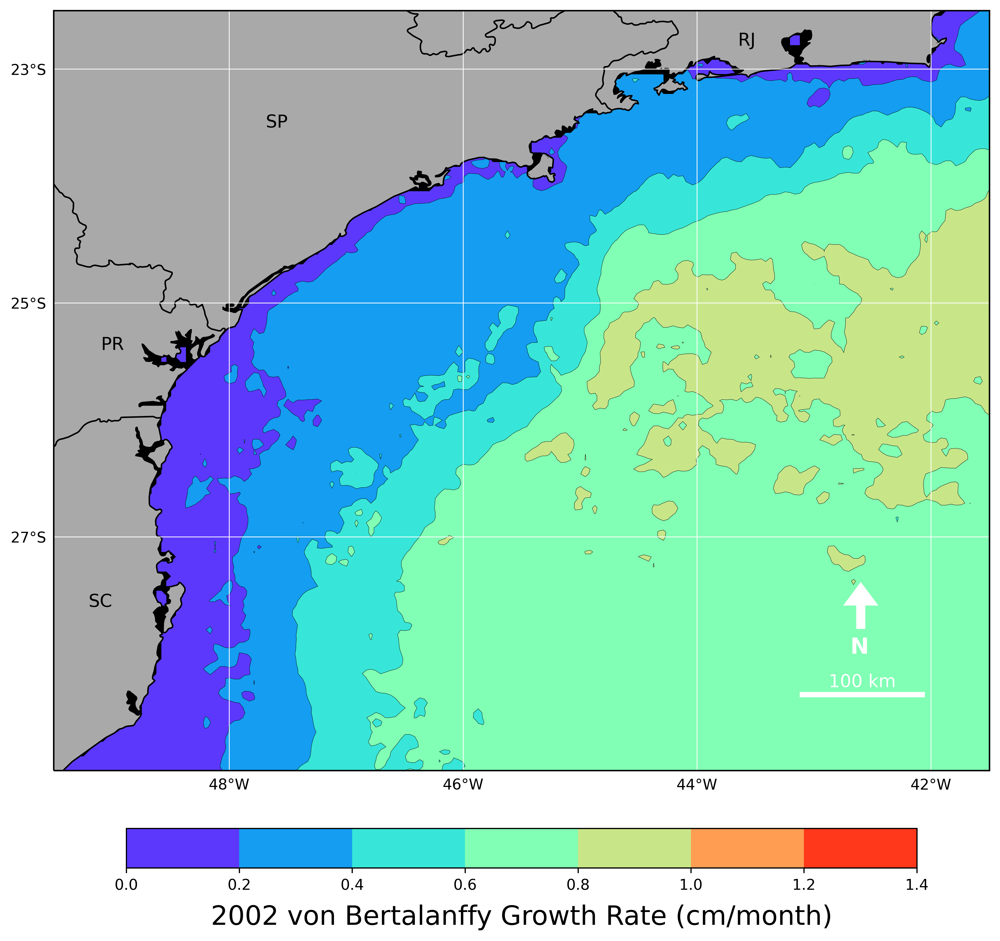

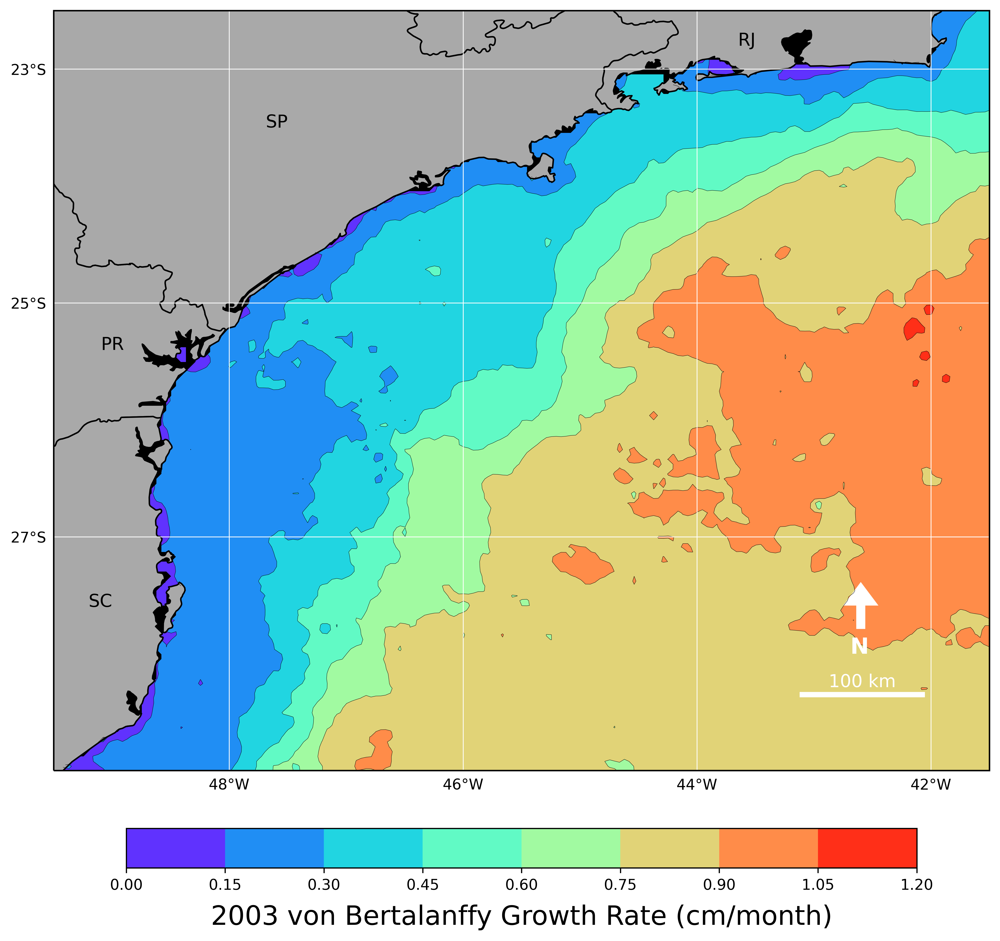

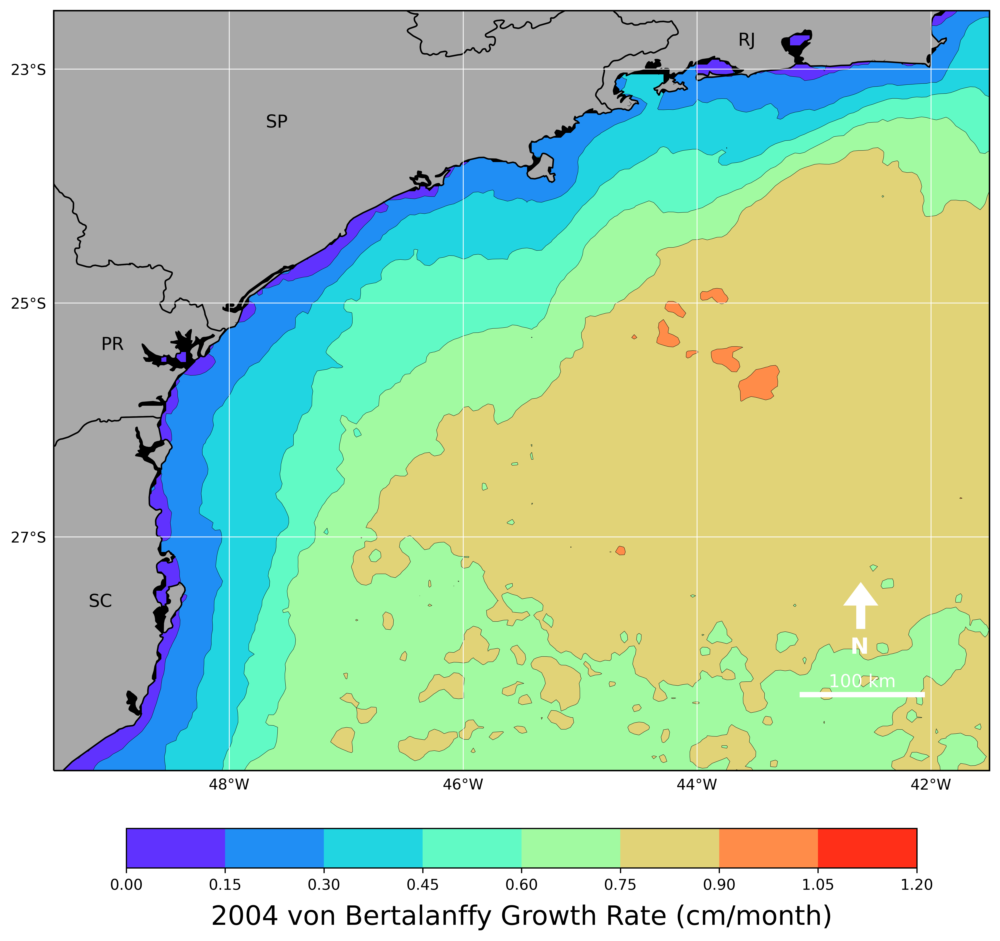

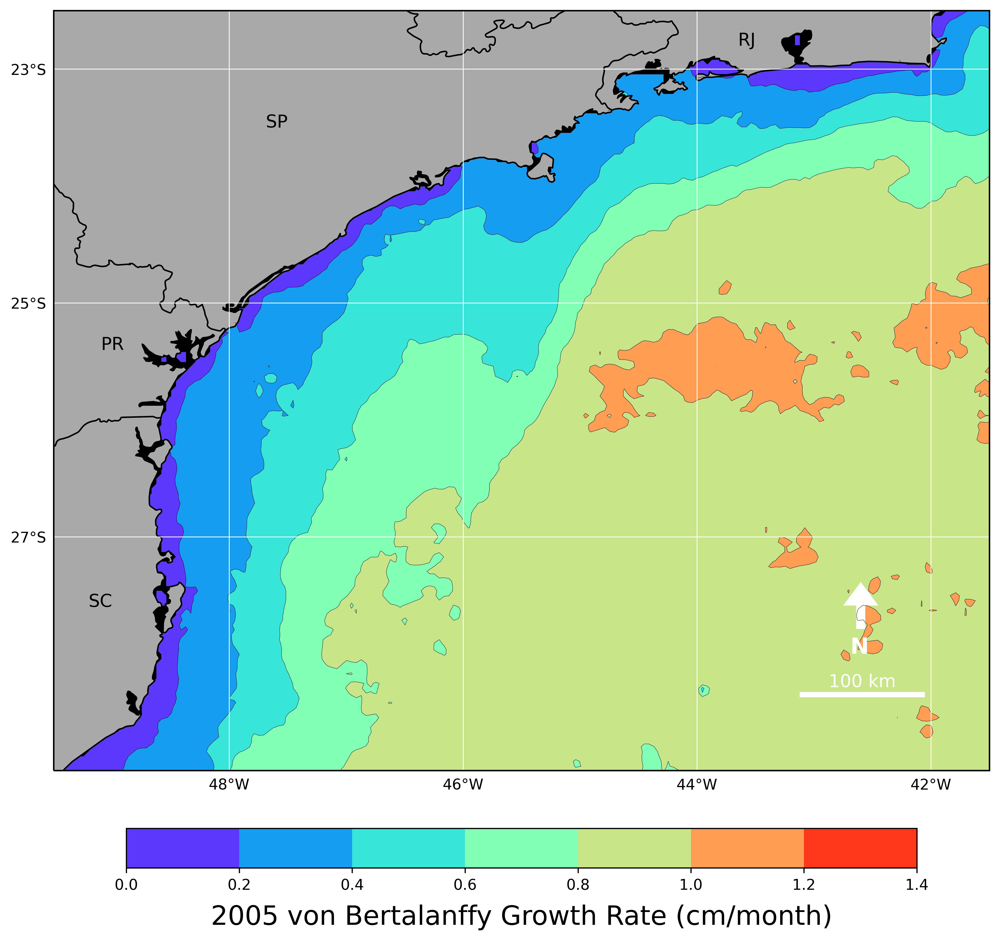

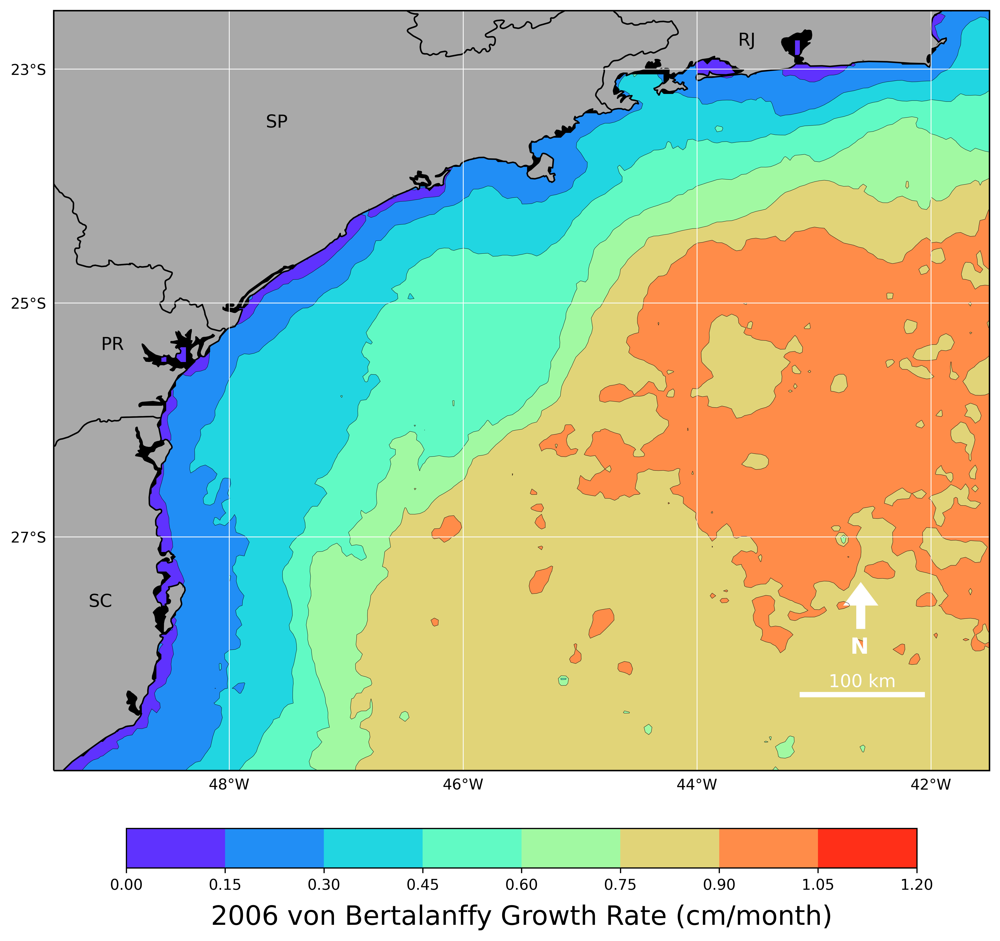

...

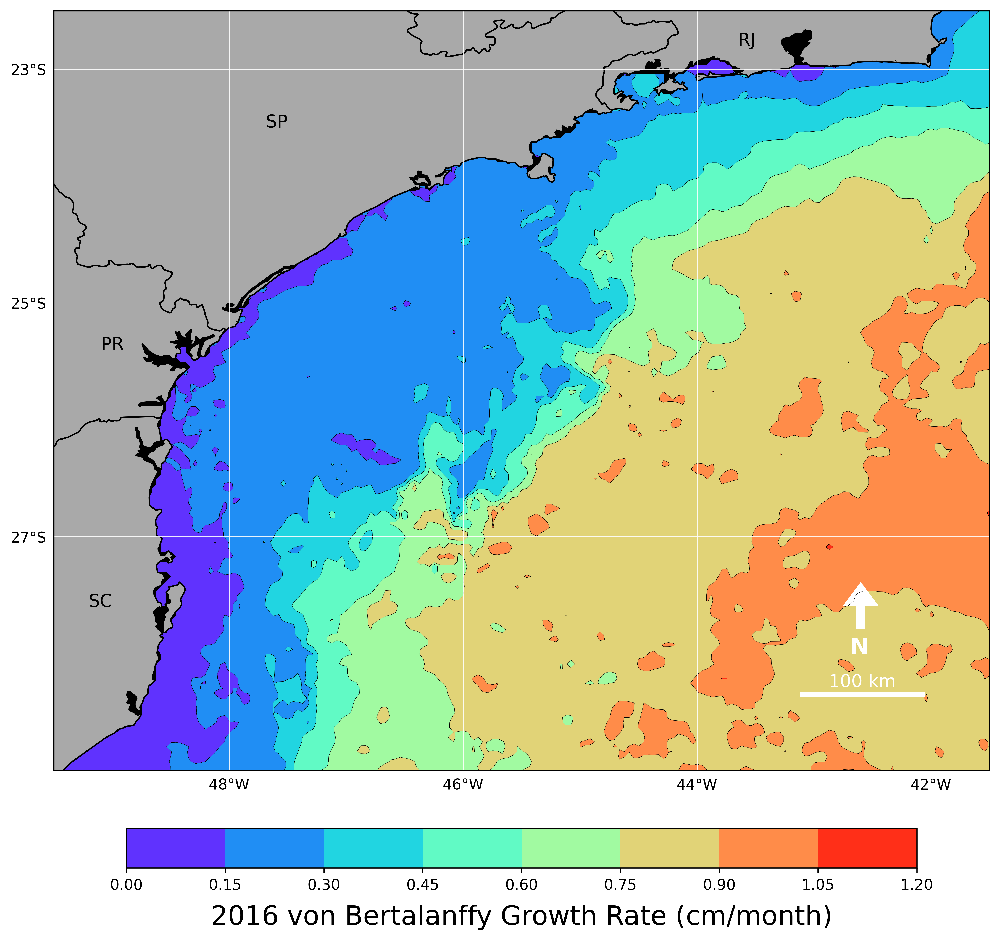

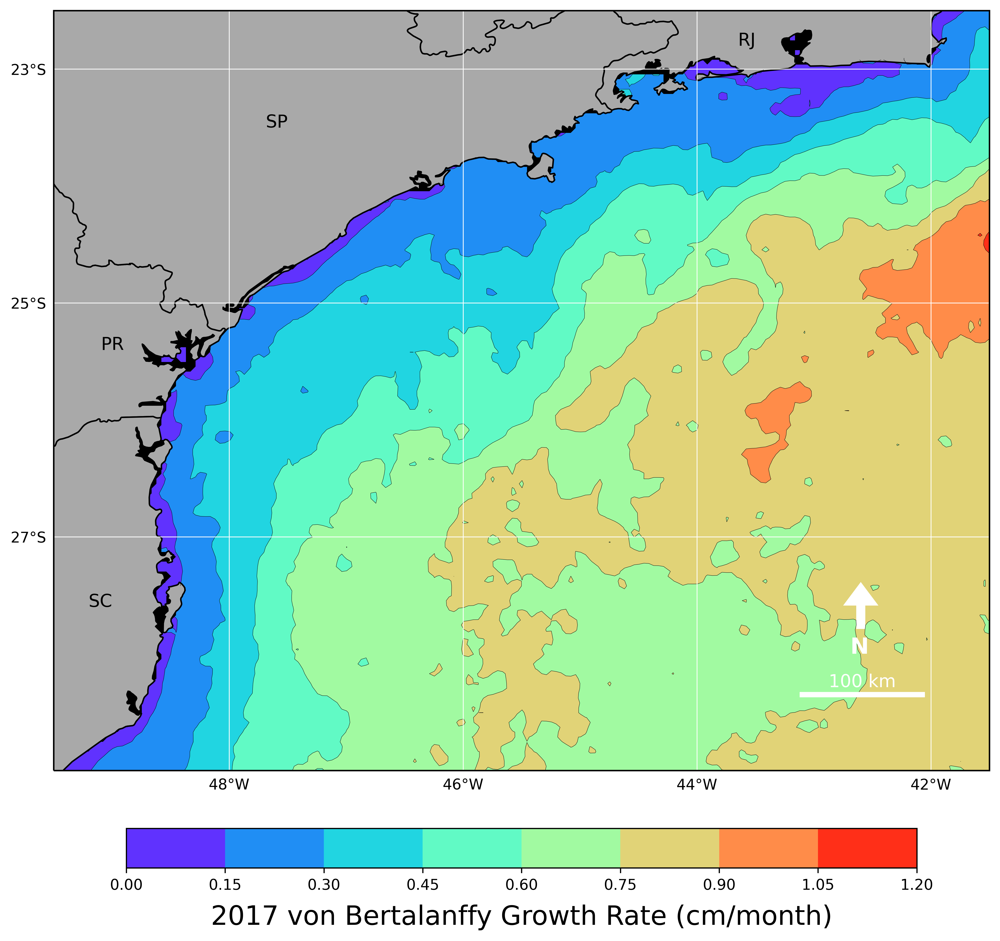

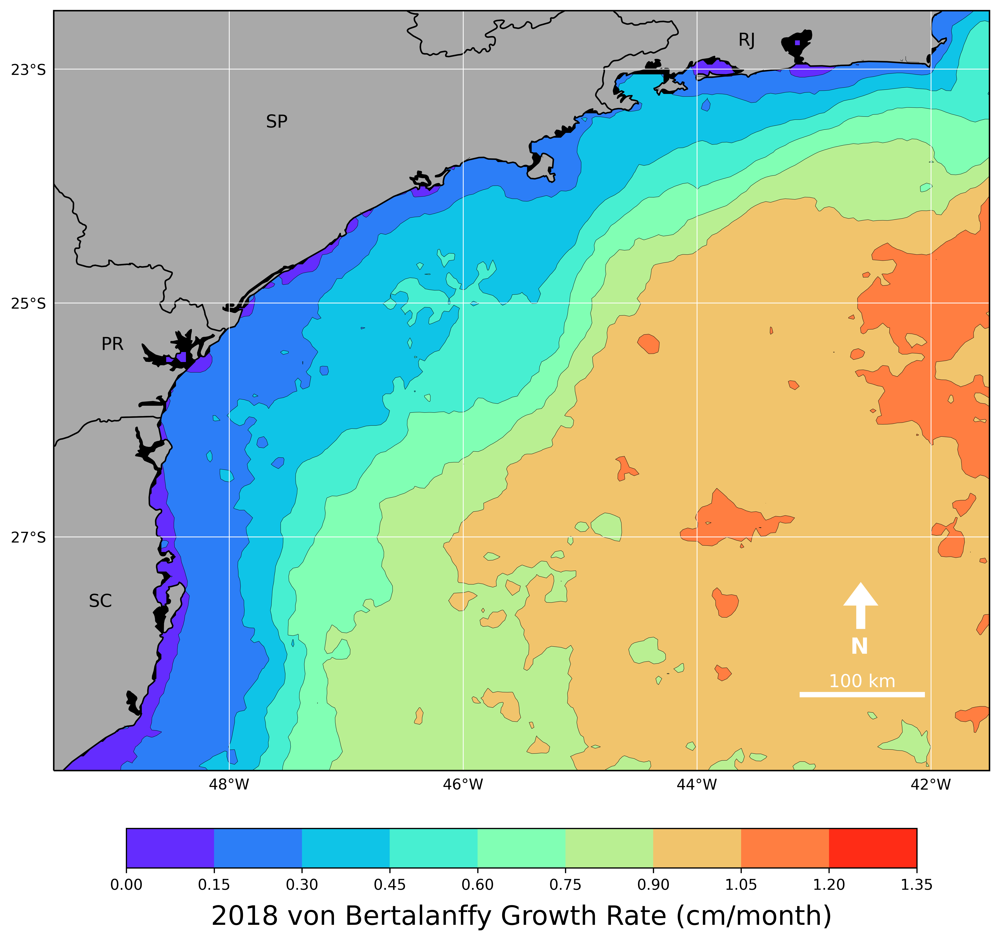

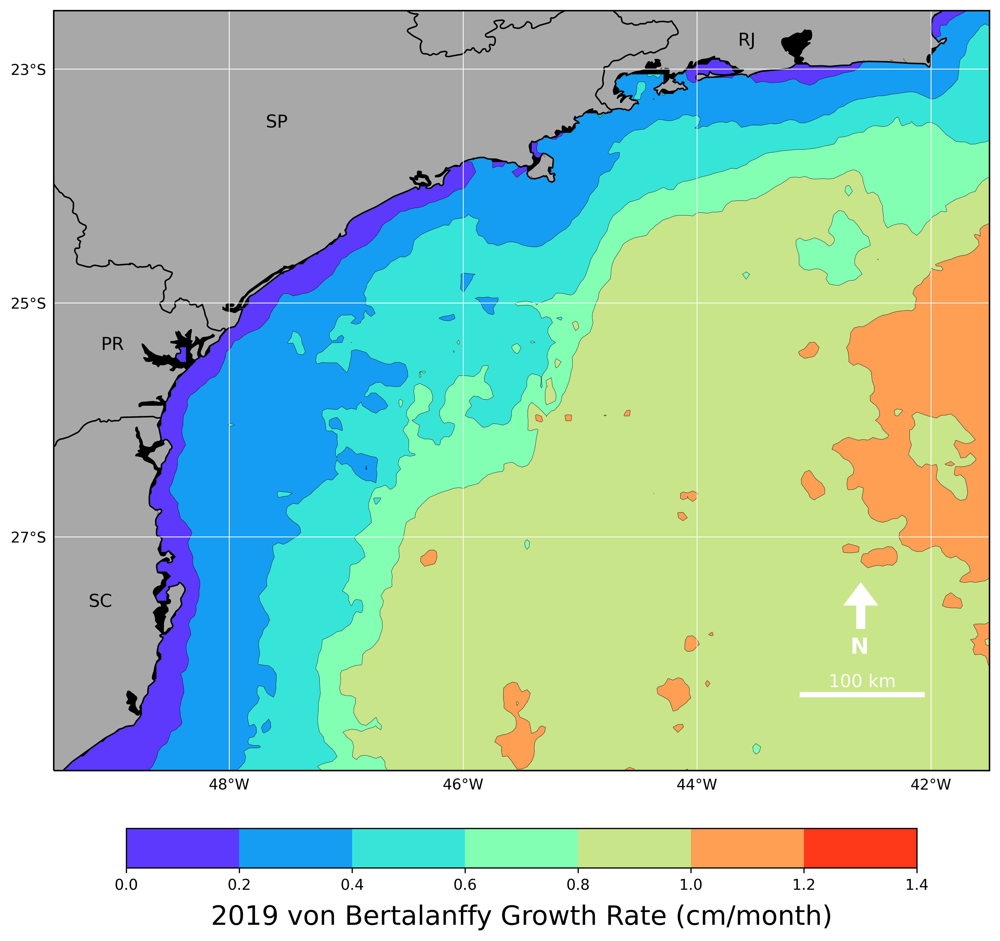

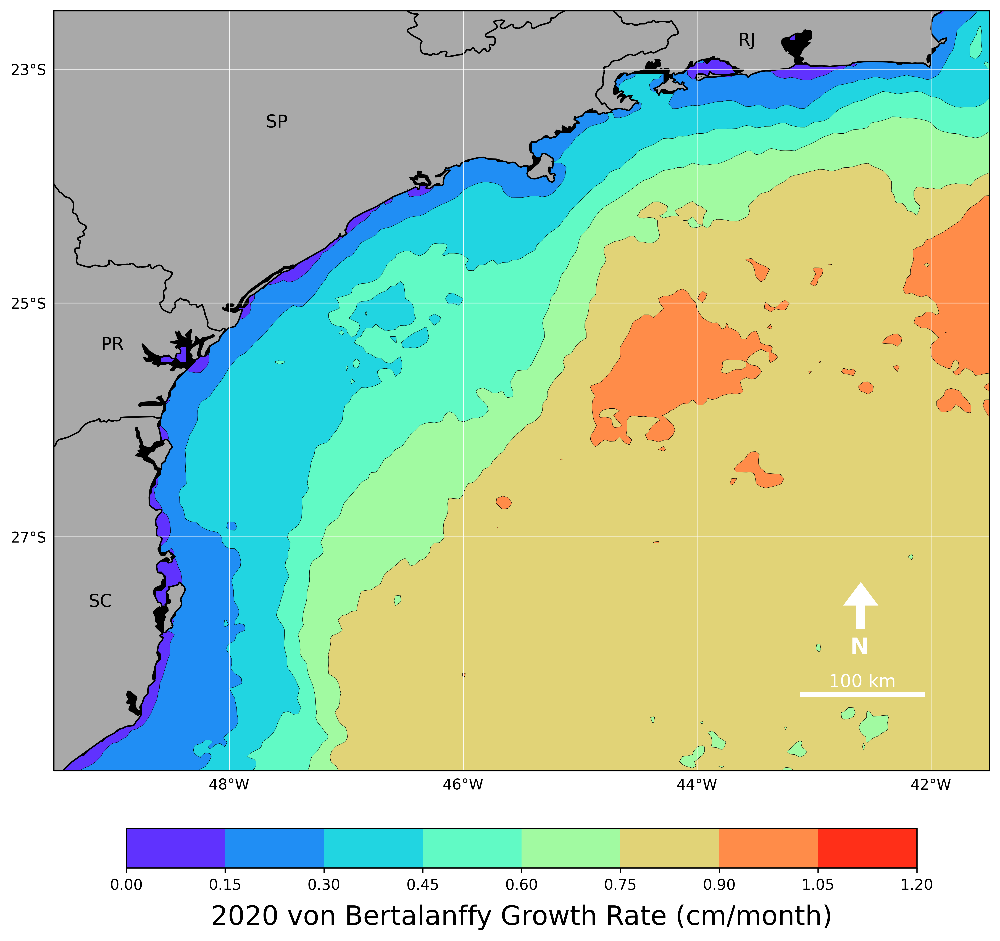

In [68]:
for i in range(len(time)):
   
    # Save different variables
    r_B = results['r_B'][str(int(time[i]))] * 30 # cm/day to cm/month & structural to physical length
     
    
    ### Start the plotting for r_B
    paises = parser.records()
    fig=plt.figure(figsize=(10, 10), dpi=600)
    ax = plt.axes(projection=ccrs.PlateCarree())
    ax.add_feature(cfeature.OCEAN, facecolor = 'k')#, alpha=.8)
    ax.add_feature(cfeature.LAND, facecolor = 'k')#, alpha=.8)

    extent = [-49.5, -41.5, -29, -22.5]
    ax.set_extent(extent)

    for estado in paises:
        if estado.attributes['admin'] == 'Brazil':        
            ax.add_geometries([estado.geometry], ccrs.PlateCarree(), facecolor='darkgray', edgecolor='k')

    plt.contourf(lon, lat, r_B, cmap = 'rainbow', 
                 transform=ccrs.PlateCarree()) #vmin=rb_min, vmax=rb_max, levels=9

    #cbaxes = inset_axes(ax, width="4%", height="60%",height="60%", loc=4)
    cbar = plt.colorbar(ax=ax, orientation="horizontal", shrink=.84, pad=.06) #ticks=range(9)
    #bins = np.linspace(0.4, 0.15, 9)
    #cbar.set_ticks(bins)
    #cbar.set_ticklabels([str(i) for i in bins])
    cbar.set_label('{} von Bertalanffy Growth Rate (cm/month)'.format(int(time[i])), fontsize = 18, labelpad = 8)

    plt.contour(lon, lat, r_B, colors='k', transform=ccrs.PlateCarree(), linewidths=0.2) #levels=9, 

    # Setting up gridlines
    gl = ax.gridlines(draw_labels=True, linewidth=0.6, color='white', alpha=0.9)
    gl.xlabels_top = False
    gl.ylabels_right = False
    gl.xlocator = mticker.FixedLocator([-52, -50, -48, -46, -44, -42, -40, -38])
    gl.ylocator = mticker.FixedLocator([-21, -23, -25, -27, -29, -31])
    gl.xformatter = LONGITUDE_FORMATTER
    gl.yformatter = LATITUDE_FORMATTER

    # State name labels
    plt.text(-43.5, -22.8, 'RJ', horizontalalignment='right', transform=ccrs.PlateCarree(), 
             size='large', color='k')
    plt.text(-47.5, -23.5, 'SP', horizontalalignment='right', transform=ccrs.PlateCarree(), 
             size='large', color='k')
    plt.text(-48.9, -25.4, 'PR', horizontalalignment='right', transform=ccrs.PlateCarree(), 
             size='large', color='k')
    plt.text(-49, -27.6, 'SC', horizontalalignment='right', transform=ccrs.PlateCarree(), 
             size='large', color='k')

    # Set scale bar (using scalebar.py, not cartopy)
    text_kwargs = dict(size='large')
    plot_kwargs = dict(linewidth=3.6)
    scale_bar(ax, (0.8, 0.1), 100, text_kwargs=text_kwargs, plot_kwargs=plot_kwargs, color='white')

    # North arrow
    plt.arrow(-42.6, -27.75, 0, 0.2, linewidth=6, head_width=0.15, head_length=0.1, 
              fc='white', ec='white', transform=ccrs.PlateCarree())
    plt.text(-42.53, -28, 'N', horizontalalignment='right', transform=ccrs.PlateCarree(), 
             fontsize = 15, weight='bold', color='white')

    fig.canvas.draw()
    plt.tight_layout(pad=3.55)

    plt.savefig('plt_rB_std_PCSE_{}'.format(int(time[i])), dpi = 600, facecolor='white')
  

## Yearly density plot

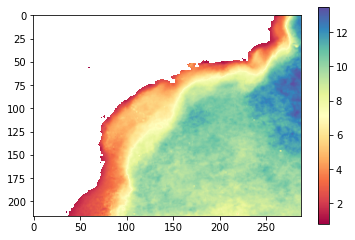

In [59]:
plt.imshow(results['r_B']['2020']*360, cmap='Spectral')
plt.colorbar()

In [12]:
#Creating a yearly data frame in pandas

cnames = ['Year', 'r_B', 'L_i']
df = pd.DataFrame(columns = cnames)
df_mean = pd.DataFrame(columns = cnames)
df_median = pd.DataFrame(columns = cnames)

for i in range(len(time)):
    # Load .mat files by year
    mat = scipy.io.loadmat(r'C:\Users\Tan\Dropbox\DEBtool\Perna_perna\DEBmatrix{}.mat'.format(int(time[i])))
    
    # Save different variables
    r_B = np.array(mat['r_B_corr'])
    L_i = np.array(mat['L_i_corr'])
    
    ### Add elements
    year = init+i

    r_B_array = r_B[~np.isnan(r_B)] #must transform matrix into 1D array for plotting
        
    L_i_array = L_i[~np.isnan(L_i)]
    
    #Open up arrays in data frame
    df_year = pd.Series('{}'.format(year))
    df_year = df_year.repeat(len(r_B_array))
    df_year = pd.DataFrame(df_year, columns=['Year'])
    df_year = df_year.reset_index()
    df_year = df_year.drop('index', axis=1)
    
    df_rb = pd.DataFrame(r_B_array, columns=['r_B'])
    df_li = pd.DataFrame(L_i_array, columns=['L_i'])
         
    df1 = df_rb.join(df_li, how='outer')
    df1 = df1.join(df_year, how='outer') 
    
    df = df.append(df1, ignore_index=True)
    
    #Another dataframe for the means
    
    rm = pd.Series(np.mean(r_B_array))
    lm = pd.Series(np.mean(L_i_array))
    y = pd.Series('{}'.format(year))
    
    rb_mean = pd.DataFrame(rm, columns=['r_B'])
    li_mean = pd.DataFrame(lm, columns=['L_i'])
    year_mean = pd.DataFrame(y, columns=['Year'])
    
    df_mean1 = rb_mean.join(li_mean, how='outer')
    df_mean1 = df_mean1.join(year_mean, how='outer')
    
    df_mean = df_mean.append(df_mean1, ignore_index=True)
    
    #Same for median
    rmd = pd.Series(np.median(r_B_array))
    lmd = pd.Series(np.median(L_i_array))
    
    rb_median = pd.DataFrame(rmd, columns=['r_B'])
    li_median = pd.DataFrame(lmd, columns=['L_i'])
    year_median = pd.DataFrame(y, columns=['Year'])
    
    df_median1 = rb_median.join(li_median, how='outer')
    df_median1 = df_median1.join(year_mean, how='outer')
    
    df_median = df_median.append(df_median1, ignore_index=True)

#Organize outputs
df = df[['Year', 'r_B', 'L_i']]
df_mean = df_mean[['Year', 'r_B', 'L_i']]
df_median = df_median[['Year', 'r_B', 'L_i']]
df_mean

,Year,r_B,L_i
0,2002,0.009718,3.688807
1,2003,0.012811,3.425177
2,2004,0.011436,3.852661
3,2005,0.012311,3.782003
4,2006,0.012195,3.796742
5,2007,0.013040,3.666449
6,2008,0.011395,3.877950
7,2009,0.012218,3.939083
8,2010,0.012335,3.755469
9,2011,0.011564,3.791898


In [13]:
df_median

,Year,r_B,L_i
0,2002,0.009707,3.208359
1,2003,0.012882,2.934729
2,2004,0.011585,3.327696
3,2005,0.012400,3.250030
4,2006,0.012173,3.303640
5,2007,0.013308,3.057248
6,2008,0.011552,3.334556
7,2009,0.012317,3.373768
8,2010,0.012380,3.130600
9,2011,0.011528,3.179404


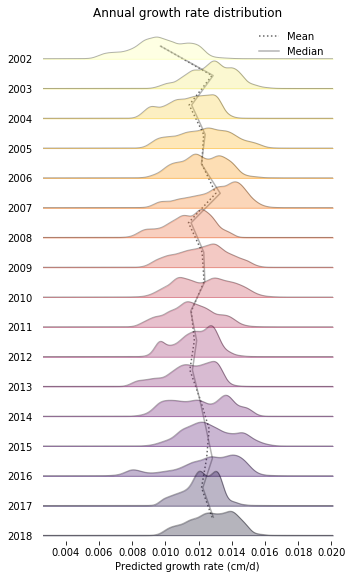

In [16]:
fig, axes = joypy.joyplot(df, by="Year", column="r_B",figsize=(5,8),
                         linewidth=1, overlap=.3, alpha=.3, colormap=cm.inferno_r,
                         title = "Annual growth rate distribution")
plt.xlabel('Predicted growth rate (cm/d)')

plt.plot(df_mean.r_B, df_mean.Year, linestyle='dotted', color='k', alpha=.6)
plt.plot(df_median.r_B, df_mean.Year, linestyle='solid', color='grey', alpha=.6)
plt.gca().invert_yaxis()
plt.legend(['Mean', 'Median'], frameon=False)

#plt.savefig('plt_rB_AnnualDistribution', dpi = 500)

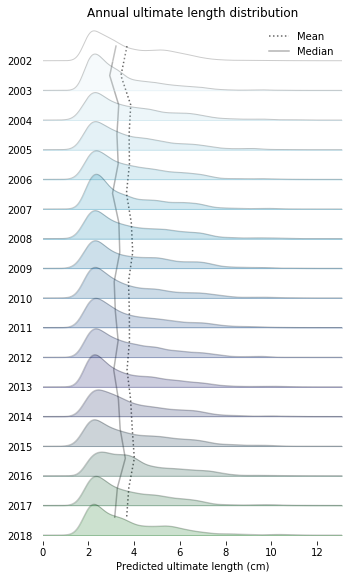

In [17]:
fig, axes = joypy.joyplot(df, by="Year", column="L_i",figsize=(5,8),
                         linewidth=1, overlap=.35, alpha=.2, colormap=cm.ocean_r,
                         title="Annual ultimate length distribution")

plt.xlabel('Predicted ultimate length (cm)')

plt.plot(df_mean.L_i, df_mean.Year, linestyle='dotted', color='k', alpha=.6)
plt.plot(df_median.L_i, df_mean.Year, linestyle='solid', color='grey', alpha=.6)
plt.gca().invert_yaxis()
plt.legend(['Mean', 'Median'], frameon=False)

#plt.savefig('plt_Li_AnnualDistribution', dpi = 500)